Prompt 2:
Regional Variations and Economic Impact:
1. What are the trends in average age for the most productive counties in the U.S., as
measured by the dollar value of agricultural production? What about the lowest
productive counties in the U.S.?
2. At the state level, how does the average age of farmers correlate with the economic
scale of farms? Specifically, do larger, more economically significant farms exhibit a
more pronounced aging trend?
3. In counties where agricultural production is declining, are there underlying
demographic patterns in terms of farmer age?**bold text**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Guide to the variables: We start off initializing these dataframes, extracting them from our drive. All of these files were given, except for the df_real_sales, which was modified based on historical inflation data and then exported as its own csv file.

Because of how computationally expensive it was to convert the data from nominal dollars to real 2022 dollars, the code that did these conversions is provided but never ran, and the resulting data is simply exported in.

In [2]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

In [3]:
df_landtotals = pd.read_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/prompt2_demos_landtotals_county.csv')
df_sales = pd.read_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/prompt2_prompt3_sales.csv')
df_inflation = pd.read_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/inflation_GDP_price_index.csv')
df_county_sales = pd.read_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/sales_data_county.csv')
df_county_sales_nominal = pd.read_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/sales_data_county.csv')
# df_real_sales = pd.read_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/real_dollar_sales_county.csv')

<ipython-input-3-08d1ffe21eec>:1: DtypeWarning: Columns (25,27,51,52,69,88,93,101,146,154,159) have mixed types. Specify dtype option on import or set low_memory=False.
  df_landtotals = pd.read_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/prompt2_demos_landtotals_county.csv')
<ipython-input-3-08d1ffe21eec>:2: DtypeWarning: Columns (3,7,30,32,36,37,40,48,49,50,54,55,56,61,71,72,81,82,83,86,91,112,138,140,144,145,146,160,162,163,166,188,189,192,194,208,210,211,214,216,217,218,240,241,244,245,246,249,251,252,253,257,258,259,263,264,265,269,279,291,292,295,296,297,306,307,310,311,312,313,316,317,318,319,329,330,331,349,351,352,353,357,359,361,366,374,375,378,379,380,387,388,389,393,394,397,433,434,437,439,440,443,445,446,447,455,457,458,459,469,471,473,474,476,478,479,481,483,484,486,488,489,491,493,494,496,498,499,501,503,504,508,510,512,513,515,517,518,520,522,523,525,527,528,530,532,537,543,549,555,557,558,561,562,563,564,568,569,573,574,578,579,589,615,616,619,620,622,

In [4]:
df_sales.shape

(18746, 1481)

In [ ]:
# Data cleaning: Change nominal dollars to 2022 real dollars in sales_data_county.
def nominal_to_2022real():
  # These are the inflation numbes.
  index_values = [(df_inflation.iloc[38])[i] for i in range(2, 35)]
  years = [i for i in range(1990, 2023)]

  # Short for conversion rates
  rates = {}
  for i in range(len(years)):
      rates[years[i]] = index_values[i]

  # Find out which columns we will actually have to convert for.
  dollars_columns = []
  for col in df_county_sales.columns:
      if "DOLLARS" in col:
          dollars_columns.append(col)

  # Helper function that actually does the converting calculations
  def conv_to_2022(amount, year):
      # String possibly with commas, get rid of them
      if type(amount) == str:
          amount = amount.replace(",", "")

          # If it is a string of numbers, then do this
          if amount.isnumeric():
              amount = float(amount)
              rate = 100 / float(rates[year])
              return amount * rate
          else:
              return 0
  df = df_county_sales
  for idx, row in df.iterrows():
      year = row['YEAR']
      for col in dollars_columns:
          df.loc[idx, col] = conv_to_2022(row[col], year)
  df.to_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/real_dollar_sales_county.csv')

In [ ]:
# Nominal Cleaning
def clean_nominal():
  # Find out which columns we will actually have to convert for.
  dollars_columns = []
  for col in df_county_sales_nominal.columns:
      if "DOLLARS" in col:
          dollars_columns.append(col)

  # Helper function that actually does the converting calculations
  def clean_num(amount):
      # String possibly with commas, get rid of them
      if type(amount) == str:
          amount = amount.replace(",", "")
      return amount

  for idx, row in df_county_sales_nominal.iterrows():
      year = row['YEAR']
      for col in dollars_columns:
          df_county_sales_nominal.loc[idx, col] = conv_to_2022(row[col])
  # df.to_csv('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/real_dollar_sales_county.csv')

#hopefully at this point in the code, df_county_sales_nominal should be properly cleaned.

In [ ]:
# Data cleaning: Change nominal dollars to 2022 real dollars in sales_data_county.

# These are all of the
index_values = [(df_inflation.iloc[38])[i] for i in range(2, 35)]
years = [i for i in range(1990, 2023)]

# Short for conversion rates
rates = {}
for i in range(len(years)):
    rates[years[i]] = index_values[i]

dollars_columns = []
for col in df_county_sales.columns:
    if "DOLLARS" in col:
        dollars_columns.append(col)

def conv_to_2022(amount, year):
    # String possibly with commas, get rid of them
    if type(amount) == str:
        amount = amount.replace(",", "")

        # If it is a string of numbers, then do this
        if amount.isnumeric():
            amount = float(amount)
            rate = 100 / float(rates[year])
            return amount * rate
        else:
            return 0

for idx, row in df_county_sales.iterrows():
    year = row['YEAR']
    for col in dollars_columns:
        df_county_sales.loc[idx, col] = conv_to_2022(row[col], year)

<ipython-input-31-539abcfff962>:4: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



In [ ]:
# Find the first 3 columns
first_three_columns = df_sales.iloc[:, :3]

# Drop sum totals, Hawaii, and Alaska
df_sales = df_sales[df_sales['STATE_FIPS_CODE'] != 2]
df_sales = df_sales[df_sales['STATE_FIPS_CODE'] != 15]
df_sales = df_sales[df_sales['STATE_FIPS_CODE'] != 999]

# Assemble Dataframe and code by if ACRES are involved
acres_columns = [col for col in df_sales.columns if "ACRES" in col]
acres_columns = [col for col in acres_columns if not "_TO_" in col]
acres_columns = [col for col in acres_columns if not "IRRIGATED" in col]
acres_columns = [col for col in acres_columns if not "OPERATIONS" in col]
acres_columns = [col for col in acres_columns if not "PRODUCTION" in col]
acres_columns = [col for col in acres_columns if not "NON_BEARING" in col]
df_sales_acres = df_sales[first_three_columns.columns.tolist() + acres_columns]

# Replace (D) and (Z) values
df_sales_acres = df_sales_acres.replace(['(Z)', '(D)'], np.nan)

# Convert to float
df_sales_acres = df_sales_acres.apply(pd.to_numeric, errors='coerce')
df_sales_acres.head(10)

<ipython-input-32-11c7cdf83045>:19: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



,STATE_FIPS_CODE,COUNTY_CODE,YEAR,AG_LAND_CROPLAND_HARVESTED_ACRES,ALMONDS_ACRES_BEARING,APPLES_ACRES_BEARING,APRICOTS_ACRES_BEARING,ARONIA_BERRIES_ACRES_BEARING,ARONIA_BERRIES_ACRES_GROWN,ARTICHOKES_ACRES_HARVESTED,...,VEGETABLES_OTHER_FRESH_MARKET_ACRES_HARVESTED,VEGETABLES_OTHER_PROCESSING_ACRES_HARVESTED,WALNUTS_ENGLISH_ACRES_BEARING,WATERCRESS_ACRES_HARVESTED,WATERCRESS_FRESH_MARKET_ACRES_HARVESTED,WHEAT_ACRES_HARVESTED,WHEAT_SPRING_DURUM_ACRES_HARVESTED,WHEAT_SPRING_EXCL_DURUM_ACRES_HARVESTED,WHEAT_WINTER_ACRES_HARVESTED,WILD_RICE_ACRES_HARVESTED
0,1,1,1997,27857.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1341.0,NaN,NaN,NaN,NaN
1,1,1,2002,26132.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,847.0,NaN,NaN,847.0,NaN
2,1,1,2007,18548.0,NaN,NaN,NaN,NaN,NaN,NaN,...,35.0,NaN,NaN,NaN,NaN,1404.0,NaN,NaN,1404.0,NaN
3,1,1,2012,29676.0,NaN,NaN,NaN,NaN,NaN,NaN,...,25.0,NaN,NaN,NaN,NaN,2917.0,NaN,NaN,2917.0,NaN
4,1,1,2017,27557.0,NaN,NaN,NaN,NaN,NaN,NaN,...,70.0,NaN,NaN,NaN,NaN,334.0,NaN,NaN,334.0,NaN
5,1,1,2022,26377.0,NaN,NaN,NaN,NaN,NaN,NaN,...,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,1,3,1997,94668.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,6596.0,NaN,NaN,NaN,NaN
7,1,3,2002,74462.0,NaN,1.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,5934.0,NaN,NaN,5934.0,NaN
8,1,3,2007,82402.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,5963.0,NaN,NaN,5963.0,NaN
9,1,3,2012,91571.0,NaN,NaN,NaN,NaN,NaN,NaN,...,15.0,NaN,NaN,NaN,NaN,12876.0,NaN,NaN,12876.0,NaN


In [ ]:
# Find the mean of the proportions and also return all columns that are greater than the proportion mean (side note)
import numpy as np
import pandas as pd

# Function to rank crops based on proportions and return columns greater than the mean proportion
def rank_crops(dataframe):
    # Final list to store results for each row
    final_results = []

    # Iterate by row / Initialize total harvest amount, proportions, and greater than mean
    for index, row in dataframe.iterrows():
        state = row.iloc[0]
        county = row.iloc[1]
        year = row.iloc[2]
        total = row.iloc[3]
        proportions = []
        greater_than_mean_columns = []

        # Calculate valid proportions and store column names
        for col_name, value in row.iloc[3:].items():
            # Skip NaN values
            if pd.isna(value):
                continue

            # Calculate valid proportions
            proportion = value / total
            proportions.append([proportion, col_name])

        # Extract proportions and calculate mean
        proportions_values = [p[0] for p in proportions]
        proportions_mean = np.mean(proportions_values)

        # Collect columns with proportions greater than the mean
        for proportion, col_name in proportions:
            if proportion > proportions_mean:
                greater_than_mean_columns.append(col_name)

        # Create a dictionary for the current row and append to the final results list
        row_result = {
            "STATE_FIPS_CODE": state,
            "COUNTY_CODE": county,
            "YEAR": year,
            "CROPS_GREATER_THAN_MEAN": greater_than_mean_columns
        }

        final_results.append(row_result)

    # Return the final results for all rows
    return final_results

ranked_crops = rank_crops(df_sales_acres)

# Display first 5 results
ranked_crops[:5]

/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide



[{'STATE_FIPS_CODE': 1.0,
  'COUNTY_CODE': 1.0,
  'YEAR': 1997.0,
  'CROPS_GREATER_THAN_MEAN': ['AG_LAND_CROPLAND_HARVESTED_ACRES',
   'COTTON_ACRES_HARVESTED']},
 {'STATE_FIPS_CODE': 1.0,
  'COUNTY_CODE': 1.0,
  'YEAR': 2002.0,
  'CROPS_GREATER_THAN_MEAN': ['AG_LAND_CROPLAND_HARVESTED_ACRES',
   'COTTON_ACRES_HARVESTED',
   'COTTON_UPLAND_ACRES_HARVESTED',
   'HAY_ACRES_HARVESTED',
   'HAY_HAYLAGE_ACRES_HARVESTED']},
 {'STATE_FIPS_CODE': 1.0,
  'COUNTY_CODE': 1.0,
  'YEAR': 2007.0,
  'CROPS_GREATER_THAN_MEAN': ['AG_LAND_CROPLAND_HARVESTED_ACRES',
   'COTTON_ACRES_HARVESTED',
   'COTTON_UPLAND_ACRES_HARVESTED',
   'HAY_ACRES_HARVESTED',
   'HAY_HAYLAGE_ACRES_HARVESTED']},
 {'STATE_FIPS_CODE': 1.0,
  'COUNTY_CODE': 1.0,
  'YEAR': 2012.0,
  'CROPS_GREATER_THAN_MEAN': ['AG_LAND_CROPLAND_HARVESTED_ACRES',
   'COTTON_ACRES_HARVESTED',
   'COTTON_UPLAND_ACRES_HARVESTED',
   'HAY_ACRES_HARVESTED',
   'HAY_HAYLAGE_ACRES_HARVESTED',
   'WHEAT_ACRES_HARVESTED',
   'WHEAT_WINTER_ACRES_HARVESTED']

In [ ]:
# Frequency List
def frequency_list(crops_dict_list):
    # Initialize dictionary to store the frequency of each crop
    frequency_list = {}

    # Iterate through the list of dictionaries
    for row in crops_dict_list:
        # Get the list of crops greater than the mean for this row
        crops_greater_than_mean = row["CROPS_GREATER_THAN_MEAN"]

        # Count the occurrences of each crop in the list
        for crop in crops_greater_than_mean:
            if crop in frequency_list:
                frequency_list[crop] += 1
            else:
                frequency_list[crop] = 1

    return frequency_list

freaky = frequency_list(ranked_crops)
print(freaky)

{'AG_LAND_CROPLAND_HARVESTED_ACRES': 18174, 'COTTON_ACRES_HARVESTED': 1860, 'COTTON_UPLAND_ACRES_HARVESTED': 1528, 'HAY_ACRES_HARVESTED': 10567, 'HAY_HAYLAGE_ACRES_HARVESTED': 10730, 'WHEAT_ACRES_HARVESTED': 4511, 'WHEAT_WINTER_ACRES_HARVESTED': 2992, 'HAY_EXCL_ALFALFA_ACRES_HARVESTED': 3232, 'CORN_GRAIN_ACRES_HARVESTED': 8232, 'SOYBEANS_ACRES_HARVESTED': 7872, 'PEANUTS_ACRES_HARVESTED': 569, 'PECANS_ACRES_BEARING': 81, 'OATS_ACRES_HARVESTED': 81, 'HAYLAGE_ACRES_HARVESTED': 2345, 'HAYLAGE_EXCL_ALFALFA_ACRES_HARVESTED': 1119, 'PEACHES_ACRES_BEARING': 23, 'NON_CITRUS_TOTALS_EXCL_BERRIES_ACRES_BEARING': 419, 'CUCUMBERS_PROCESSING_PICKLES_ACRES_HARVESTED': 2, 'VEGETABLE_TOTALS_IN_THE_OPEN_ACRES_HARVESTED': 1218, 'TREE_NUT_TOTALS_ACRES_BEARING': 199, 'HAY_ALFALFA_ACRES_HARVESTED': 4112, 'SWEET_CORN_ACRES_HARVESTED': 154, 'SWEET_CORN_FRESH_MARKET_ACRES_HARVESTED': 73, 'VEGETABLE_TOTALS_IN_THE_OPEN_FRESH_MARKET_ACRES_HARVESTED': 506, 'CORN_TRADITIONAL_OR_INDIAN_ACRES_HARVESTED': 10, 'PECANS_I

In [ ]:
# Get keys from frequency list
keys = freaky.keys()

# Create a list from the key list
greater_than_mean_columns = [col for col in keys]

# Create list from OG data set
df_columns_clean = [col for col in df_sales_acres.columns]

# Combine lists
columns_to_keep_with_base = df_columns_clean[:3] + [col for col in greater_than_mean_columns if col in df_columns_clean]

# Filter by indexes of columns
filtered_df_sales_acres = df_sales_acres[columns_to_keep_with_base]

# Ensure floats once again for safety
filtered_df_sales_acres = filtered_df_sales_acres.apply(pd.to_numeric, errors='coerce')
filtered_df_sales_acres.tail(100)

,STATE_FIPS_CODE,COUNTY_CODE,YEAR,AG_LAND_CROPLAND_HARVESTED_ACRES,COTTON_ACRES_HARVESTED,COTTON_UPLAND_ACRES_HARVESTED,HAY_ACRES_HARVESTED,HAY_HAYLAGE_ACRES_HARVESTED,WHEAT_ACRES_HARVESTED,WHEAT_WINTER_ACRES_HARVESTED,...,GRASSES_ORCHARDGRASS_SEED_ACRES_HARVESTED,GRASSES_RYEGRASS_SEED_ACRES_HARVESTED,HAZELNUTS_ACRES_BEARING,PEARS_EXCL_BARTLETT_ACRES_BEARING,GRASSES_LEGUMES_OTHER_SEED_ACRES_HARVESTED,LEGUMES_CLOVER_WHITE_SEED_ACRES_HARVESTED,HOPS_ACRES_HARVESTED,LEGUMES_CLOVER_RED_SEED_ACRES_HARVESTED,LEGUMES_CLOVER_CRIMSON_SEED_ACRES_HARVESTED,MINT_SPEARMINT_OIL_ACRES_HARVESTED
18646,56,17,2002,13855.0,NaN,NaN,12206.0,12206.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18647,56,17,2007,14117.0,NaN,NaN,12126.0,12806.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18648,56,17,2012,15199.0,NaN,NaN,13223.0,13825.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18649,56,17,2017,10210.0,NaN,NaN,10002.0,10002.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18650,56,17,2022,11333.0,NaN,NaN,10048.0,10892.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18741,99,999,2002,302697252.0,12456162.0,12223770.0,60645417.0,64041337.0,45519976.0,29303293.0,...,23923.0,290963.0,31753.0,NaN,44075.0,NaN,NaN,43936.0,3166.0,21327.0
18742,99,999,2007,309607601.0,10493238.0,10202566.0,58121003.0,61455483.0,50932969.0,35785969.0,...,21517.0,307722.0,31903.0,NaN,48117.0,4059.0,31145.0,21387.0,3496.0,22346.0
18743,99,999,2012,314964600.0,9384080.0,9143938.0,51539584.0,55775162.0,49040226.0,34723361.0,...,13762.0,245146.0,30463.0,NaN,27351.0,5027.0,29683.0,17087.0,6392.0,19168.0
18744,99,999,2017,320041858.0,11401965.0,11149431.0,50466457.0,56858622.0,38811620.0,26186417.0,...,12807.0,232139.0,43965.0,29503.0,47257.0,9546.0,59429.0,21937.0,7639.0,23574.0


In [ ]:
#create dataframe with only columns that have ages
# num_rows = 18765, num_cols = 21

#only include cols that have 'age' in the column name
age_cols = [col for col in df_landtotals.columns if 'AGE_' in col]

#add in the state,county, and year data into the list of column names
age_cols[:0] = reversed(['STATE_FIPS_CODE','COUNTY_CODE','YEAR'])

#create new dataframe with all the location, year, and age data
df_landtotals_age = df_landtotals[age_cols]
df_landtotals_age.head(10)

#drop Hawaii and Alaska
df_landtotals_age = df_landtotals_age[df_landtotals_age['STATE_FIPS_CODE'] != 2]
df_landtotals_age = df_landtotals_age[df_landtotals_age['STATE_FIPS_CODE'] != 15]

#convert all numerical age data into floats, removing (D) and (Z) values
df_landtotals_age = df_landtotals_age.apply(pd.to_numeric, errors = 'coerce')
df_landtotals_age.head()

,YEAR,COUNTY_CODE,STATE_FIPS_CODE,OPERATORS_PRINCIPAL_AGE_25_TO_34_NUMBER_OF_OPERATORS,OPERATORS_PRINCIPAL_AGE_35_TO_44_NUMBER_OF_OPERATORS,OPERATORS_PRINCIPAL_AGE_45_TO_54_NUMBER_OF_OPERATORS,OPERATORS_PRINCIPAL_AGE_55_TO_59_NUMBER_OF_OPERATORS,OPERATORS_PRINCIPAL_AGE_60_TO_64_NUMBER_OF_OPERATORS,OPERATORS_PRINCIPAL_AGE_65_TO_69_NUMBER_OF_OPERATORS,OPERATORS_PRINCIPAL_AGE_AVG_MEASURED_IN_YEARS,...,OPERATORS_PRINCIPAL_AGE_LT_25_NUMBER_OF_OPERATORS,PRODUCERS_AGE_25_TO_34_NUMBER_OF_PRODUCERS,PRODUCERS_AGE_35_TO_44_NUMBER_OF_PRODUCERS,PRODUCERS_AGE_45_TO_54_NUMBER_OF_PRODUCERS,PRODUCERS_AGE_55_TO_64_NUMBER_OF_PRODUCERS,PRODUCERS_AGE_65_TO_74_NUMBER_OF_PRODUCERS,PRODUCERS_AGE_AVG_MEASURED_IN_YEARS,PRODUCERS_AGE_GE_75_NUMBER_OF_PRODUCERS,PRODUCERS_AGE_LT_25_NUMBER_OF_PRODUCERS,PRODUCERS_AGE_LT_35_NUMBER_OF_PRODUCERS
0,1997,1,1,24.0,60.0,91.0,60.0,66.0,37.0,57.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2002,1,1,13.0,43.0,97.0,47.0,48.0,53.0,58.1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2007,1,1,27.0,59.0,77.0,56.0,70.0,36.0,56.2,...,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2012,1,1,20.0,42.0,65.0,36.0,68.0,56.0,58.2,...,12.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2017,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,54.0,66.0,84.0,149.0,138.0,57.0,68.0,9.0,NaN


In [ ]:
#Combine the operators and producer columns, joining each column and replacing their nan values
col_names = df_landtotals_age.columns
for i in range(3,12):
  df_landtotals_age[col_names[i][20:]+"_AND_PRODUCERS"] = df_landtotals_age[col_names[i]].fillna(df_landtotals_age[col_names[i+8]])

#drop old columns
df_landtotals_age = df_landtotals_age.drop(df_landtotals_age.columns[3:21], axis=1)
df_landtotals_age = df_landtotals_age.drop(df_landtotals_age.columns[3:9], axis=1)
df_landtotals_age = df_landtotals_age.drop(df_landtotals_age.columns[4:6], axis=1)
df_landtotals_age.head()

,YEAR,COUNTY_CODE,STATE_FIPS_CODE,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS
0,1997,1,1,57.4
1,2002,1,1,58.1
2,2007,1,1,56.2
3,2012,1,1,58.2
4,2017,1,1,57.0


In [ ]:
#remove rows that have county codes of 999
df_no_999 = df_landtotals_age.loc[df_landtotals_age['COUNTY_CODE'] != 999]

#initialize list of years
years = [1997,2002,2007,2012,2017,2022]
df_year_list = []
df_state_year_list = []



#for each year, create a dataframe containing FIP code and the average age of both operators and producers
for year in years:
  df_year = df_no_999.loc[df_no_999['YEAR'] == year]

  #Add leading zeros to the state and county fip codes
  df_year['STATE_FIPS_CODE'] = df_year['STATE_FIPS_CODE'].astype(str).str.zfill(2)
  state_level = df_year.groupby("STATE_FIPS_CODE")['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'].mean()
  state_level= state_level.reset_index()

  df_year['COUNTY_CODE'] = df_year['COUNTY_CODE'].astype(str).str.zfill(3)

  #Concatenate the state and county codes together
  df_year['FIPS']= df_year['STATE_FIPS_CODE'] + df_year['COUNTY_CODE']

  #initialize the dataframe with only FIP codes and average year
  df_map_year = df_year[['FIPS','AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS']]
  df_year_list.append(df_map_year)
  df_state_year_list.append(state_level)


<ipython-input-38-046ac1eceed5>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-38-046ac1eceed5>:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-38-046ac1eceed5>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-38-046a

In [ ]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)


In [ ]:
import plotly.express as px
#plot chart
fig = px.choropleth(df_year_list[4], geojson=counties, locations='FIPS', color='AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS',
                           color_continuous_scale="Viridis",
                           range_color=(45, 65),
                           scope="usa",
                           labels={'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS':'Average Age'}
                          )
fig.update_layout(title_text = f'{years[4]} Average Farmer Age By County')
fig.show()


In [ ]:
#average age by year among all states
for i in range(len(years)-1):
  df_state_year_list[0][f'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_{years[i+1]}'] = df_state_year_list[i+1]['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS']

df_all_years = df_state_year_list[0]
df_all_years.rename(columns = {'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS':'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_1997'}, inplace =True)

df_all_years

,STATE_FIPS_CODE,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_1997,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2002,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2007,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2012,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2017,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2022
0,01,55.216418,57.062687,57.953731,59.620896,58.428358,59.035821
1,04,55.940000,55.793333,58.400000,61.066667,59.526667,59.393333
2,05,53.380000,54.894667,56.482667,58.048000,57.162667,57.640000
3,06,55.072414,56.403448,58.143103,59.731034,58.837931,59.479310
4,08,54.168254,55.300000,57.569841,59.598413,58.180952,58.831746
5,09,55.050000,55.512500,57.662500,58.612500,56.987500,58.250000
6,10,53.900000,55.466667,55.700000,58.500000,57.800000,58.866667
7,12,56.173134,56.768657,58.098507,59.723881,58.655224,59.376119
8,13,55.706289,56.623899,57.940881,60.122013,58.024528,59.040252
9,16,53.513636,54.597727,57.059091,58.431818,56.959091,57.181818


In [ ]:
#find change in average age among all states between only 1997 and 2022
df_all_years['2022-1997 Average Age'] = df_all_years[f'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2022'] - df_all_years[f'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_1997']

df_all_years.sort_values('2022-1997 Average Age',ascending=False)

,STATE_FIPS_CODE,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_1997,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2002,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2007,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2012,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2017,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2022,2022-1997 Average Age
44,53,53.505128,55.751282,57.361538,59.084615,58.628205,60.071795,6.566667
20,27,51.288506,53.195402,55.656322,56.760920,56.428736,57.086207,5.797701
23,30,53.746429,55.407143,57.950000,58.894643,58.171429,59.308929,5.562500
12,19,52.419192,54.422222,56.307071,57.283838,57.614141,57.863636,5.444444
26,33,53.600000,54.100000,56.310000,58.030000,57.680000,59.040000,5.440000
10,17,53.356863,55.199020,56.320588,58.035294,58.028431,58.529412,5.172549
31,38,51.545283,54.549057,56.533962,57.060377,56.039623,56.666038,5.120755
38,46,52.034848,53.612121,55.824242,56.081818,56.243939,57.112121,5.077273
6,10,53.900000,55.466667,55.700000,58.500000,57.800000,58.866667,4.966667
42,50,52.921429,53.957143,56.278571,57.128571,55.828571,57.814286,4.892857


In [ ]:
#find rate of change between each two years
for x in range(2,7):
  df_all_years[f'{x}'] = (df_all_years[f'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_{years[x-1]}'] - df_all_years[f'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_{years[x-2]}'])/2

df_all_years['Average Rate of Change'] = df_all_years[['2','3','4','5']].mean(axis=1)

df_all_years.head(10)

df_all_years.sort_values(by='Average Rate of Change', ascending=False)

,STATE_FIPS_CODE,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_1997,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2002,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2007,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2012,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2017,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS_2022,2022-1997 Average Age,2,3,4,5,6,Average Rate of Change
12,19,52.419192,54.422222,56.307071,57.283838,57.614141,57.863636,5.444444,1.001515,0.942424,0.488384,0.165152,0.124747,0.649369
20,27,51.288506,53.195402,55.656322,56.760920,56.428736,57.086207,5.797701,0.953448,1.230460,0.552299,-0.166092,0.328736,0.642529
44,53,53.505128,55.751282,57.361538,59.084615,58.628205,60.071795,6.566667,1.123077,0.805128,0.861538,-0.228205,0.721795,0.640385
10,17,53.356863,55.199020,56.320588,58.035294,58.028431,58.529412,5.172549,0.921078,0.560784,0.857353,-0.003431,0.250490,0.583946
31,38,51.545283,54.549057,56.533962,57.060377,56.039623,56.666038,5.120755,1.501887,0.992453,0.263208,-0.510377,0.313208,0.561792
23,30,53.746429,55.407143,57.950000,58.894643,58.171429,59.308929,5.562500,0.830357,1.271429,0.472321,-0.361607,0.568750,0.553125
38,46,52.034848,53.612121,55.824242,56.081818,56.243939,57.112121,5.077273,0.788636,1.106061,0.128788,0.081061,0.434091,0.526136
26,33,53.600000,54.100000,56.310000,58.030000,57.680000,59.040000,5.440000,0.250000,1.105000,0.860000,-0.175000,0.680000,0.510000
36,44,53.760000,54.480000,56.720000,57.380000,57.800000,57.900000,4.140000,0.360000,1.120000,0.330000,0.210000,0.050000,0.505000
4,08,54.168254,55.300000,57.569841,59.598413,58.180952,58.831746,4.663492,0.565873,1.134921,1.014286,-0.708730,0.325397,0.501587


In [ ]:
# Start of Day 2 This down here answers 2.3

# Merger
merged_df = pd.merge(df_landtotals_age, filtered_df_sales_acres,on=['STATE_FIPS_CODE', 'COUNTY_CODE', 'YEAR'], how='inner')
df_awesome = pd.merge(merged_df, df_county_sales,on=['STATE_FIPS_CODE', 'COUNTY_CODE', 'YEAR'], how='inner')
df_asesome = df_awesome.apply(pd.to_numeric, errors='coerce')

# State Level File
df_state_level = pd.read_excel('/content/drive/MyDrive/HDSI_Datathon/HDSI_AGRI_Prompt_2/state_level_2002_2007_2012_2017_2022.xlsx')
df_state_level.rename(columns={'State ANSI': 'STATE_FIPS_CODE'}, inplace=True)
df_state_level.rename(columns={'Year': 'YEAR'}, inplace=True)

# Merge for SUPAAAA
df_super = pd.merge(df_awesome, df_state_level,on=['STATE_FIPS_CODE', 'YEAR'], how='inner')
df_super.head(10)

,YEAR,COUNTY_CODE,STATE_FIPS_CODE,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS,AG_LAND_CROPLAND_HARVESTED_ACRES,COTTON_ACRES_HARVESTED,COTTON_UPLAND_ACRES_HARVESTED,HAY_ACRES_HARVESTED,HAY_HAYLAGE_ACRES_HARVESTED,WHEAT_ACRES_HARVESTED,...,"FARM SALES: (1,000 TO 2,499 $)","FARM SALES: (2,500 TO 4,999 $)","FARM SALES: (5,000 TO 9,999 $)","FARM SALES: (10,000 TO 24,999 $)","FARM SALES: (25,000 TO 49,999 $)","FARM SALES: (50,000 TO 99,999 $)","FARM SALES: (100,000 TO 249,999 $)","FARM SALES: (250,000 TO 499,999 $)","FARM SALES: (500,000 TO 999,999 $)","FARM SALES: (1,000,000 OR MORE $)"
0,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,49,22,36,29,23,8,9,4,14,1
1,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,282,266,230,186,89,82,60,66,82,44
2,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,1057,898,788,574,255,157,219,263,301,135
3,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,751,697,621,505,174,169,186,216,189,116
4,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,888,877,828,622,239,147,190,228,207,111
5,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,917,892,812,711,289,178,196,260,206,98
6,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,753,847,809,745,258,185,181,182,162,53
7,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,616,704,741,679,229,122,112,122,77,42
8,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,947,1225,1218,1155,378,198,127,100,77,35
9,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,55.3,57,57.6,58.7,57.2,55.7,53.8,53.2,51.3,50.7


In [ ]:
# All work for Nominal Variable Comparison
df_awesome_alt = pd.merge(merged_df, df_county_sales_nominal,on=['STATE_FIPS_CODE', 'COUNTY_CODE', 'YEAR'], how='inner')
df_awesome_alt['ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES'].head(10)

,ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES
0,296
1,226
2,214
3,166
4,188
5,186
6,607
7,476
8,484
9,394


In [ ]:
# This is the Nominal Comparison

# Convert to floats (Handle conversion properly)
df_awesome_alt['AG_LAND_CROPLAND_HARVESTED_ACRES'] = pd.to_numeric(df_awesome_alt['AG_LAND_CROPLAND_HARVESTED_ACRES'], errors='coerce')
df_awesome_alt['ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES'] = pd.to_numeric(df_awesome_alt['ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES'], errors='coerce')

# Drop rows with NaNs in the required columns
df_awesome_alt_productivity = df_awesome_alt.dropna(subset=[
    'AG_LAND_CROPLAND_HARVESTED_ACRES',
    'ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES',
    'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'
])

# Drop US coded states and counties
df_awesome_alt_productivity = df_awesome_alt_productivity[df_awesome_alt_productivity['STATE_FIPS_CODE'] != 99]
df_awesome_alt_productivity = df_awesome_alt_productivity[df_awesome_alt_productivity['COUNTY_CODE'] != 999]

# Production valued in harvests and sells
df_awesome_alt_productivity['PRODUCTION'] = df_awesome_alt_productivity['AG_LAND_CROPLAND_HARVESTED_ACRES'] + df_awesome_alt_productivity['ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES']

# National Level Summary of OLS

import statsmodels.api as sm

# Create dependent and independent variables
y = df_awesome_alt_productivity['PRODUCTION']
X = df_awesome_alt_productivity['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS']
X = sm.add_constant(X)

# Model
model = sm.OLS(y, X).fit()

# Display the results
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:             PRODUCTION   R-squared:                       0.057
Model:                            OLS   Adj. R-squared:                  0.057
Method:                 Least Squares   F-statistic:                     1033.
Date:                Mon, 07 Oct 2024   Prob (F-statistic):          3.93e-220
Time:                        03:06:48   Log-Likelihood:            -2.2431e+05
No. Observations:               17140   AIC:                         4.486e+05
Df Residuals:                   17138   BIC:                         4.486e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                              coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------

<ipython-input-46-2653234cdebc>:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Convert to floats (Handle conversion properly)
df_super['AG_LAND_CROPLAND_HARVESTED_ACRES'] = pd.to_numeric(df_super['AG_LAND_CROPLAND_HARVESTED_ACRES'], errors='coerce')
df_super['ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES'] = pd.to_numeric(df_super['ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES'], errors='coerce')

# Drop rows with NaNs in the required columns
df_super_productivity = df_super.dropna(subset=[
    'AG_LAND_CROPLAND_HARVESTED_ACRES',
    'ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES',
    'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'
])

# Drop US coded states and counties
df_super_productivity = df_super_productivity[df_super_productivity['STATE_FIPS_CODE'] != 99]
df_super_productivity = df_super_productivity[df_super_productivity['COUNTY_CODE'] != 999]

# Production valued in harvests and sells
df_super_productivity['PRODUCTION'] = df_super_productivity['AG_LAND_CROPLAND_HARVESTED_ACRES'] + df_super_productivity['ANIMAL_TOTALS_INCL_PRODUCTS_OPERATIONS_WITH_SALES']

<ipython-input-47-98464b23afa6>:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
#highest produced crop type by state



df_no_string = df_super_productivity.drop(['PRODUCTION','AG_LAND_CROPLAND_HARVESTED_ACRES','COMMODITY_TOTALS_SALES_MEASURED_IN_DOLLARS'], axis=1)

production_cols = [col for col in df_no_string.columns if 'ACRES_HARVESTED' in col]

production_cols[0] = 'STATE_FIPS_CODE'

states_only = df_no_string[production_cols]

states_only = states_only.apply(pd.to_numeric, errors='coerce')

states_only = states_only.groupby("STATE_FIPS_CODE").mean()
states_only= states_only.reset_index()

states_only = states_only.set_index('STATE_FIPS_CODE')
states_only['Top_Crop'] = states_only.idxmax(axis=1)

states_only


,COTTON_UPLAND_ACRES_HARVESTED,HAY_ACRES_HARVESTED,HAY_HAYLAGE_ACRES_HARVESTED,WHEAT_ACRES_HARVESTED,WHEAT_WINTER_ACRES_HARVESTED,HAY_EXCL_ALFALFA_ACRES_HARVESTED,CORN_GRAIN_ACRES_HARVESTED,SOYBEANS_ACRES_HARVESTED,PEANUTS_ACRES_HARVESTED,OATS_ACRES_HARVESTED,...,FLAXSEED_ACRES_HARVESTED,GRASSES_ORCHARDGRASS_SEED_ACRES_HARVESTED,GRASSES_RYEGRASS_SEED_ACRES_HARVESTED,GRASSES_LEGUMES_OTHER_SEED_ACRES_HARVESTED,LEGUMES_CLOVER_WHITE_SEED_ACRES_HARVESTED,HOPS_ACRES_HARVESTED,LEGUMES_CLOVER_RED_SEED_ACRES_HARVESTED,LEGUMES_CLOVER_CRIMSON_SEED_ACRES_HARVESTED,MINT_SPEARMINT_OIL_ACRES_HARVESTED,Top_Crop
STATE_FIPS_CODE,,,,,,,,,,,,,,,,,,,,,
1,10498.073479,11016.379522,11427.930375,3104.021333,3080.430518,10972.591837,3890.453744,6254.974586,8603.475104,817.254072,...,NaN,NaN,NaN,1166.071429,NaN,NaN,NaN,NaN,NaN,HAY_HAYLAGE_ACRES_HARVESTED
4,26048.968421,26722.868852,28345.139344,15329.919708,1755.068966,5028.909091,5858.683673,NaN,NaN,192.555556,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HAY_HAYLAGE_ACRES_HARVESTED
5,34102.556745,15953.370303,15986.839394,12272.023310,12272.023310,15565.488000,14466.861991,74822.076110,3543.395062,770.748344,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,SOYBEANS_ACRES_HARVESTED
6,22481.404762,27325.696592,31171.638404,12254.376471,11517.058524,11783.477273,6080.822355,NaN,16.428571,938.891414,...,258.000000,NaN,NaN,121.666667,321.000000,7.714286,NaN,NaN,NaN,COTTON_PIMA_ACRES_HARVESTED
8,NaN,21745.359627,22498.221471,49416.177353,58058.081197,11078.774510,38934.006036,1205.976923,NaN,368.396104,...,NaN,NaN,NaN,NaN,NaN,73.705882,NaN,NaN,NaN,WHEAT_WINTER_ACRES_HARVESTED
9,NaN,7441.896739,9106.472826,22.000000,22.000000,5636.285714,765.068182,182.000000,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,3.000000,NaN,NaN,NaN,HAY_HAYLAGE_ACRES_HARVESTED
10,NaN,4037.594203,4763.536232,19164.710145,19164.710145,2228.666667,59815.826087,57316.927536,NaN,173.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CORN_GRAIN_ACRES_HARVESTED
12,10016.264840,5020.783942,5748.643934,1399.789916,1399.789916,6116.926316,1250.420489,986.198606,7001.262673,482.223214,...,NaN,NaN,4.000000,413.000000,NaN,NaN,NaN,NaN,NaN,SUGARCANE_SUGAR_SEED_ACRES_HARVESTED
13,16564.266347,3909.470888,4112.093945,2109.171588,2124.611519,3971.190955,2931.705450,2280.135383,9490.309694,416.441517,...,NaN,NaN,15.000000,12.000000,NaN,NaN,NaN,NaN,NaN,COTTON_UPLAND_ACRES_HARVESTED


In [ ]:
# National Level Summary of OLS

import statsmodels.api as sm

# Create dependent and independent variables
y = df_super_productivity['PRODUCTION']
X = df_super_productivity['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS']
X = sm.add_constant(X)

# Model
model = sm.OLS(y, X).fit()

# Display the results
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:             PRODUCTION   R-squared:                       0.054
Model:                            OLS   Adj. R-squared:                  0.054
Method:                 Least Squares   F-statistic:                     7550.
Date:                Mon, 07 Oct 2024   Prob (F-statistic):               0.00
Time:                        03:06:51   Log-Likelihood:            -1.7262e+06
No. Observations:              131892   AIC:                         3.452e+06
Df Residuals:                  131890   BIC:                         3.452e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                              coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------

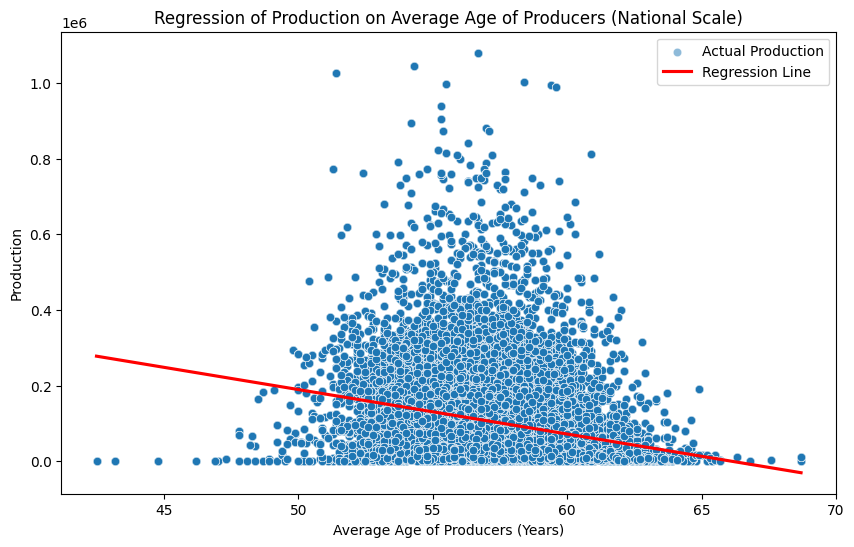

In [ ]:
# National Level Graph

import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))

# Scatter plot of actual values
sns.scatterplot(x=df_super_productivity['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'],
                y=df_super_productivity['PRODUCTION'],
                label='Actual Production', alpha=0.5)

# Plot the regression line
sns.regplot(x=df_super_productivity['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'],
            y=model.fittedvalues,
            scatter=False,
            label='Regression Line', color='red')

# Labels and Title
plt.xlabel('Average Age of Producers (Years)')
plt.ylabel('Production')
plt.title('Regression of Production on Average Age of Producers (National Scale)')

# Display the plot
plt.legend()
plt.show()

In [ ]:
# Create a dictionary for state codes and names
state_code_to_name = {
    1: 'Alabama', 2: 'Alaska', 4: 'Arizona', 5: 'Arkansas', 6: 'California',
    8: 'Colorado', 9: 'Connecticut', 10: 'Delaware', 12: 'Florida', 13: 'Georgia',
    15: 'Hawaii', 16: 'Idaho', 17: 'Illinois', 18: 'Indiana', 19: 'Iowa',
    20: 'Kansas', 21: 'Kentucky', 22: 'Louisiana', 23: 'Maine', 24: 'Maryland',
    25: 'Massachusetts', 26: 'Michigan', 27: 'Minnesota', 28: 'Mississippi', 29: 'Missouri',
    30: 'Montana', 31: 'Nebraska', 32: 'Nevada', 33: 'New Hampshire', 34: 'New Jersey',
    35: 'New Mexico', 36: 'New York', 37: 'North Carolina', 38: 'North Dakota', 39: 'Ohio',
    40: 'Oklahoma', 41: 'Oregon', 42: 'Pennsylvania', 44: 'Rhode Island', 45: 'South Carolina',
    46: 'South Dakota', 47: 'Tennessee', 48: 'Texas', 49: 'Utah', 50: 'Vermont',
    51: 'Virginia', 53: 'Washington', 54: 'West Virginia', 55: 'Wisconsin', 56: 'Wyoming'
}

# Function to fill GEO with state names based on STATE_FIPS_CODE
def fill_state_name(row):
    return state_code_to_name.get(row['STATE_FIPS_CODE'], 'Unknown')

# Apply the function to fill in the GEO column in your dataframe
df_super_productivity['GEO'] = df_super_productivity.apply(fill_state_name, axis=1)

# Check the result
print(df_super_productivity[['STATE_FIPS_CODE', 'GEO']].head())


   STATE_FIPS_CODE      GEO
0                1  Alabama
1                1  Alabama
2                1  Alabama
3                1  Alabama
4                1  Alabama


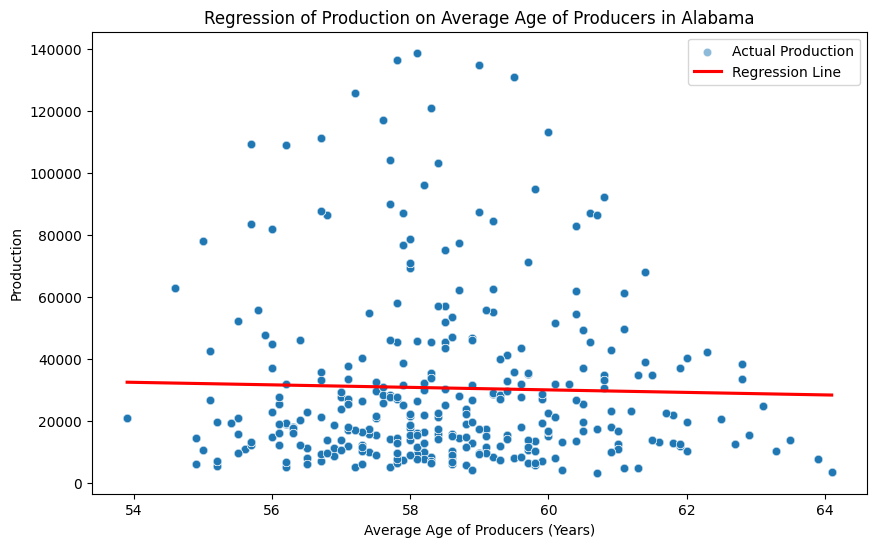

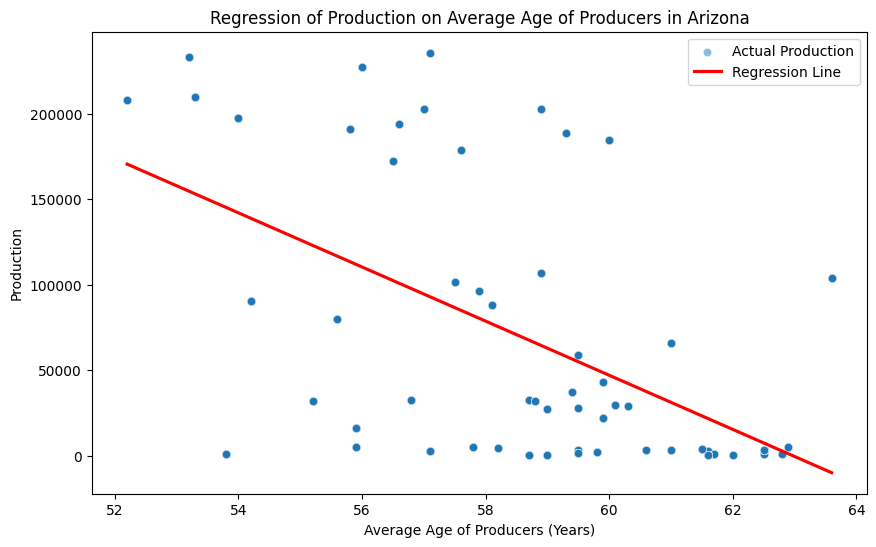

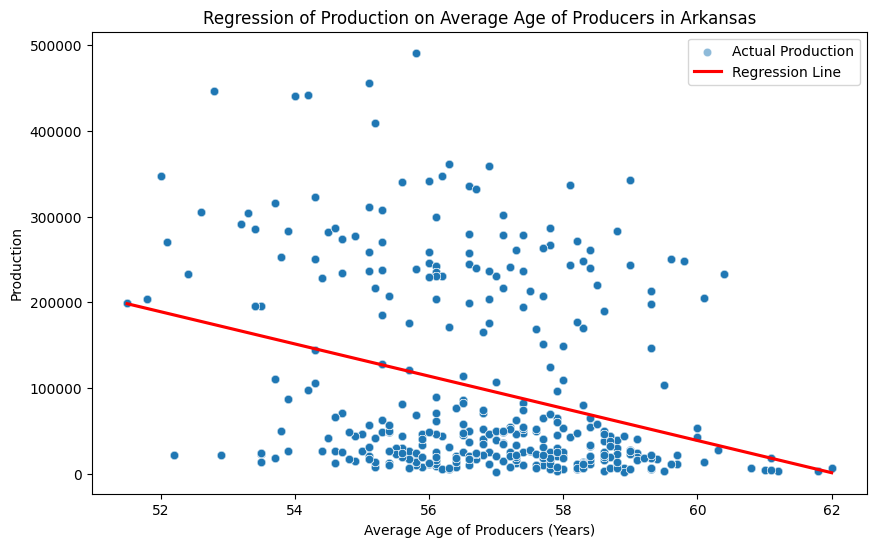

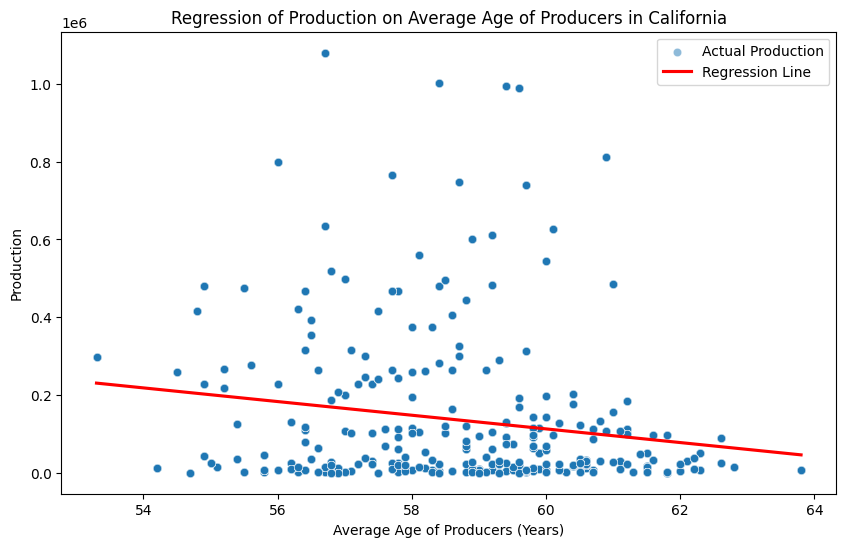

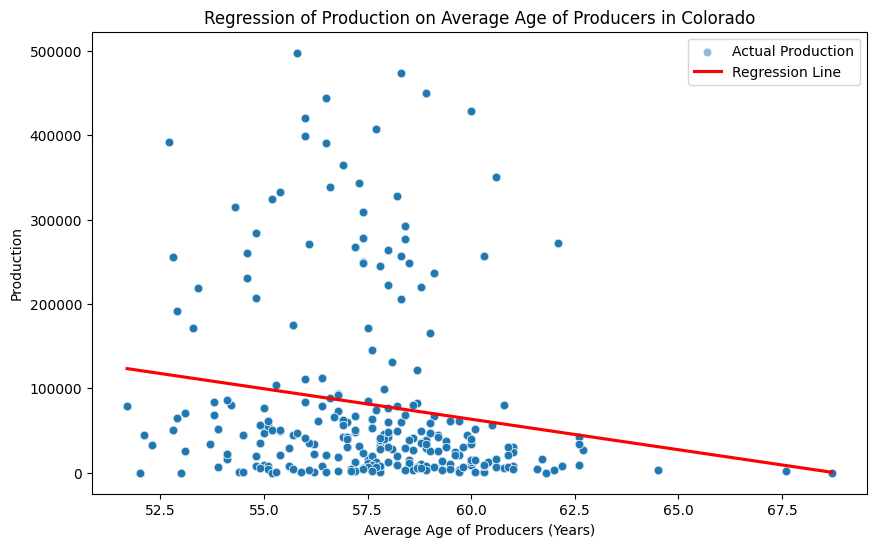

...

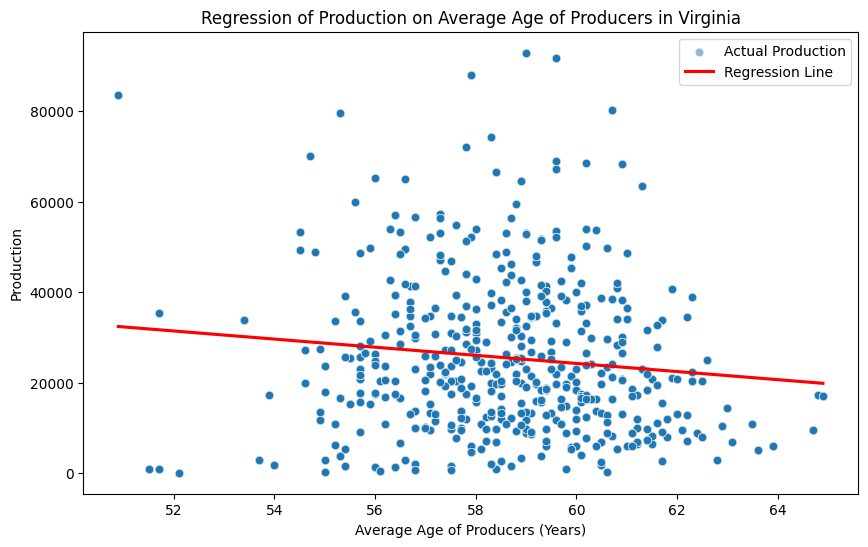

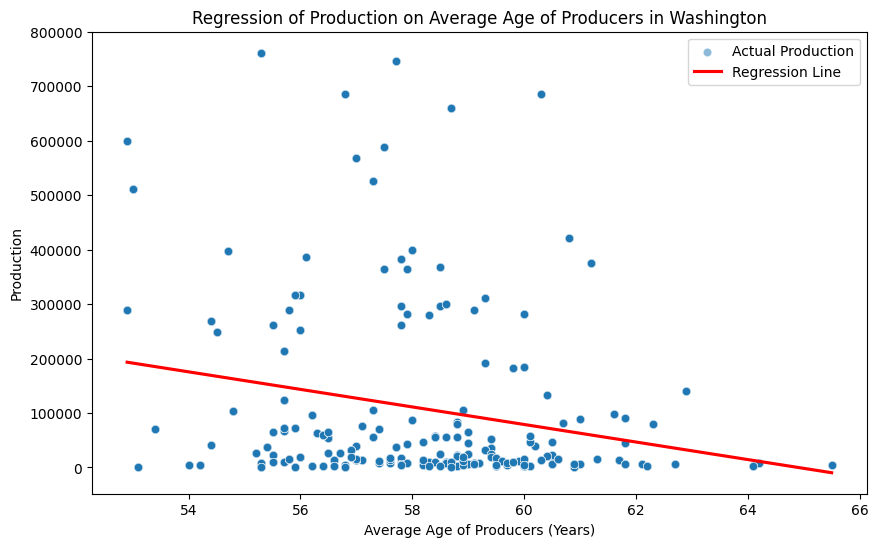

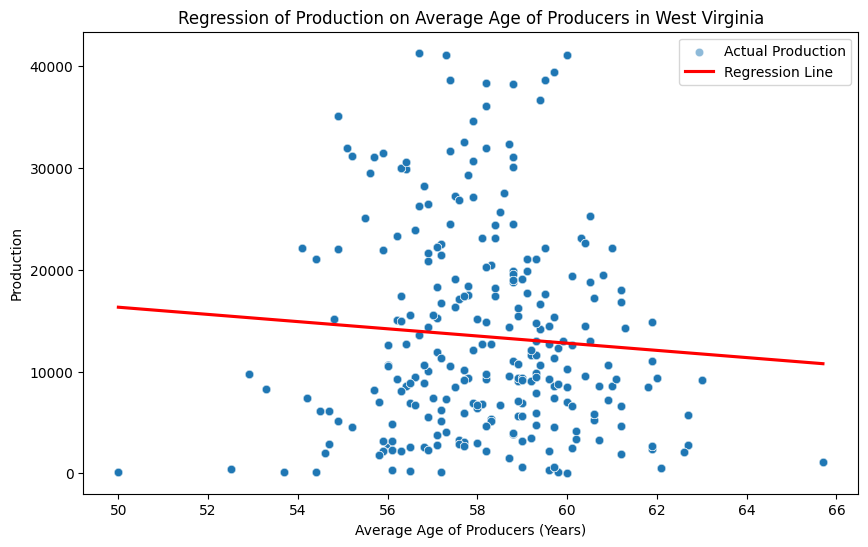

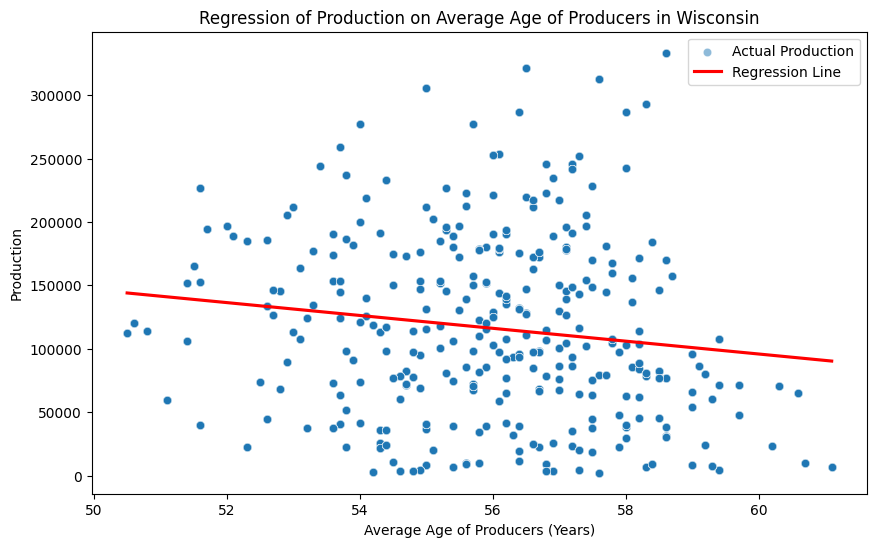

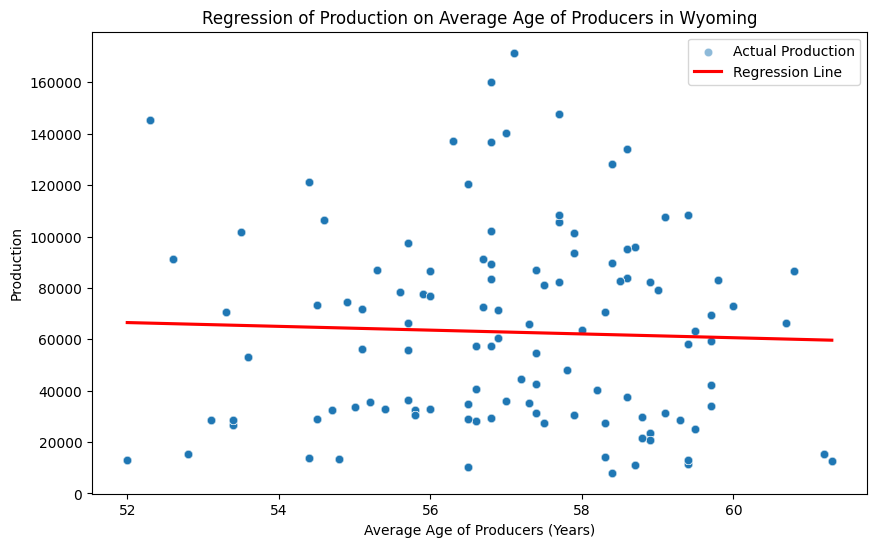

In [ ]:
# State Level Graphs and creates Slope and P-Value Coeficients on State Level

# Create the REG_COEF and REG_PVALUE columns as float type
df_super_productivity['REG_COEF_STATE'] = 0.0
df_super_productivity['REG_PVALUE_STATE'] = 0.0

# Find all unique state codes
states = df_super_productivity['STATE_FIPS_CODE'].unique()

for state in states:
    state_df = df_super_productivity[df_super_productivity['STATE_FIPS_CODE'] == state]

    state_name = state_df['GEO'].iloc[0]

    if len(state_df) > 1:
        # Establish Independent Variable
        X = state_df['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS']
        X = sm.add_constant(X)

        # Establish Dependent Variable
        y = state_df['PRODUCTION']

        # Fit OLS regression
        model = sm.OLS(y, X).fit()

        # Assign the coefficient and p-value explicitly as floats
        df_super_productivity.loc[df_super_productivity['STATE_FIPS_CODE'] == state, 'REG_COEF_STATE'] = float(model.params['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'])
        df_super_productivity.loc[df_super_productivity['STATE_FIPS_CODE'] == state, 'REG_PVALUE_STATE'] = float(model.pvalues['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'])

        plt.figure(figsize=(10, 6))

        # State Scatter Plot
        sns.scatterplot(x=state_df['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'],
                        y=state_df['PRODUCTION'],
                        label='Actual Production', alpha=0.5)

        # Plot the regression line
        sns.regplot(x=state_df['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'],
                    y=model.fittedvalues,
                    scatter=False,
                    label='Regression Line', color='red')

        # Labels and Title
        plt.xlabel('Average Age of Producers (Years)')
        plt.ylabel('Production')
        plt.title(f'Regression of Production on Average Age of Producers in {state_name}')

        # Display the plot
        plt.legend()
        plt.show()

In [ ]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json') as response:
    states = json.load(response)



# Choose your own adventure
def plot_colors():
    # Converting to abbreviations that choropleth function can read
    fips_to_state = {
        '01': 'AL', '02': 'AK', '04': 'AZ', '05': 'AR', '06': 'CA', '08': 'CO', '09': 'CT',
        '10': 'DE', '11': 'DC', '12': 'FL', '13': 'GA', '15': 'HI', '16': 'ID', '17': 'IL',
        '18': 'IN', '19': 'IA', '20': 'KS', '21': 'KY', '22': 'LA', '23': 'ME', '24': 'MD',
        '25': 'MA', '26': 'MI', '27': 'MN', '28': 'MS', '29': 'MO', '30': 'MT', '31': 'NE',
        '32': 'NV', '33': 'NH', '34': 'NJ', '35': 'NM', '36': 'NY', '37': 'NC', '38': 'ND',
        '39': 'OH', '40': 'OK', '41': 'OR', '42': 'PA', '44': 'RI', '45': 'SC', '46': 'SD',
        '47': 'TN', '48': 'TX', '49': 'UT', '50': 'VT', '51': 'VA', '53': 'WA', '54': 'WV',
        '55': 'WI', '56': 'WY'
    }

    # Narrower dataframe
    df = df_super_productivity[["STATE_FIPS_CODE", "REG_COEF_STATE"]].drop_duplicates()

    # Convert FIPS codes to state abbreviations
    df['state_abbr'] = df['STATE_FIPS_CODE'].map(lambda x: fips_to_state[str(x).zfill(2)])

    # Plotting the choropleth map
    fig = px.choropleth(df,
                        locations="state_abbr",
                        locationmode="USA-states",
                        color="REG_COEF_STATE",
                        color_continuous_scale="Viridis",
                        range_color=(-18000, 7000),
                        scope="usa")
    fig.update_layout(title_text='Regression Coefficients') # Graph title
    fig.show()
    df.head
plot_colors()


In [ ]:
top_crop = pd.DataFrame(states_only['Top_Crop'])
top_crop = top_crop.reset_index()
top_crop

,STATE_FIPS_CODE,Top_Crop
0,1,HAY_HAYLAGE_ACRES_HARVESTED
1,4,HAY_HAYLAGE_ACRES_HARVESTED
2,5,SOYBEANS_ACRES_HARVESTED
3,6,COTTON_PIMA_ACRES_HARVESTED
4,8,WHEAT_WINTER_ACRES_HARVESTED
5,9,HAY_HAYLAGE_ACRES_HARVESTED
6,10,CORN_GRAIN_ACRES_HARVESTED
7,12,SUGARCANE_SUGAR_SEED_ACRES_HARVESTED
8,13,COTTON_UPLAND_ACRES_HARVESTED
9,16,WHEAT_ACRES_HARVESTED


In [ ]:
def find_crop_avg_coeff(crop):
    # Filter the dataframe to include only rows where the crop is the top crop
    df = top_crop[top_crop["Top_Crop"] == crop]
    df_coeffs_by_state = df_super_productivity[["STATE_FIPS_CODE", "REG_COEF_STATE"]].drop_duplicates()
    avg = 0

    # Iterate through the rows of the filtered dataframe
    for _, row in df.iterrows():
        state = row["STATE_FIPS_CODE"]

        # Find the average correlation coefficient from df_super_productivity
        coeff = df_coeffs_by_state.loc[df_coeffs_by_state["STATE_FIPS_CODE"] == state, "REG_COEF_STATE"].iloc[0]
        avg += coeff

    avg /= len(df)
    return avg


crop_avgs = {}
def get_top_crops_coeffs():
    for crop in top_crop["Top_Crop"].unique():
      crop_avgs[crop] = find_crop_avg_coeff(crop)

get_top_crops_coeffs()
print(crop_avgs)

{'HAY_HAYLAGE_ACRES_HARVESTED': -2161.9171628965537, 'SOYBEANS_ACRES_HARVESTED': -5032.926950049526, 'COTTON_PIMA_ACRES_HARVESTED': -17562.624599426017, 'WHEAT_WINTER_ACRES_HARVESTED': -3722.884981692602, 'CORN_GRAIN_ACRES_HARVESTED': -9844.390741591396, 'SUGARCANE_SUGAR_SEED_ACRES_HARVESTED': -3488.3497867504575, 'COTTON_UPLAND_ACRES_HARVESTED': -2670.9828865473296, 'WHEAT_ACRES_HARVESTED': -9374.091790918475, 'POTATOES_PROCESSING_ACRES_HARVESTED': -2978.498389508626}


<ipython-input-56-5dcceae87d50>:5: UserWarning:

FixedFormatter should only be used together with FixedLocator



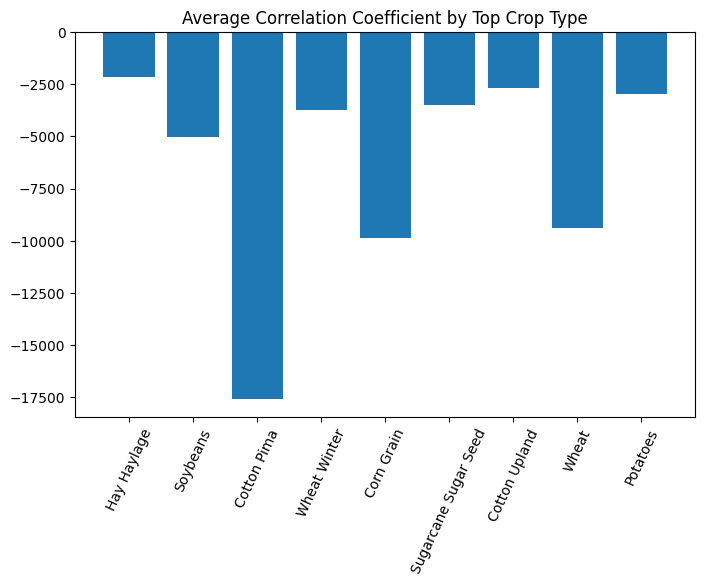

In [ ]:
import matplotlib.pyplot as plt
crop_types = ['Hay Haylage','Soybeans','Cotton Pima','Wheat Winter','Corn Grain','Sugarcane Sugar Seed','Cotton Upland','Wheat','Potatoes']
fig, ax = plt.subplots(figsize = (8,5))
ax.bar(list(crop_avgs.keys()), list(crop_avgs.values()))
ax.set_xticklabels(crop_types, rotation=65)
ax.set_title('Average Correlation Coefficient by Top Crop Type')
plt.show()

In [ ]:
df_super_productivity.head(10)

,YEAR,COUNTY_CODE,STATE_FIPS_CODE,AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS,AG_LAND_CROPLAND_HARVESTED_ACRES,COTTON_ACRES_HARVESTED,COTTON_UPLAND_ACRES_HARVESTED,HAY_ACRES_HARVESTED,HAY_HAYLAGE_ACRES_HARVESTED,WHEAT_ACRES_HARVESTED,...,"FARM SALES: (10,000 TO 24,999 $)","FARM SALES: (25,000 TO 49,999 $)","FARM SALES: (50,000 TO 99,999 $)","FARM SALES: (100,000 TO 249,999 $)","FARM SALES: (250,000 TO 499,999 $)","FARM SALES: (500,000 TO 999,999 $)","FARM SALES: (1,000,000 OR MORE $)",PRODUCTION,REG_COEF_STATE,REG_PVALUE_STATE
0,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,29,23,8,9,4,14,1,26358.0,-405.67162,0.135543
1,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,186,89,82,60,66,82,44,26358.0,-405.67162,0.135543
2,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,574,255,157,219,263,301,135,26358.0,-405.67162,0.135543
3,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,505,174,169,186,216,189,116,26358.0,-405.67162,0.135543
4,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,622,239,147,190,228,207,111,26358.0,-405.67162,0.135543
5,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,711,289,178,196,260,206,98,26358.0,-405.67162,0.135543
6,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,745,258,185,181,182,162,53,26358.0,-405.67162,0.135543
7,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,679,229,122,112,122,77,42,26358.0,-405.67162,0.135543
8,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,1155,378,198,127,100,77,35,26358.0,-405.67162,0.135543
9,2002,1,1,58.1,26132.0,7789.0,7789.0,12169.0,12206.0,847.0,...,58.7,57.2,55.7,53.8,53.2,51.3,50.7,26358.0,-405.67162,0.135543


In [ ]:
# Finding Slope and P-Value for County Level

# Create the REG_COEF and REG_PVALUE columns as float type
df_super_productivity['REG_COEF_COUNTY'] = 0.0
df_super_productivity['REG_PVALUE_COUNTY'] = 0.0

# Find all unique county codes
counties = df_super_productivity['COUNTY_CODE'].unique()

for county in counties:
    county_df = df_super_productivity[df_super_productivity['COUNTY_CODE'] == county]

    if len(county_df) > 1:
        # Establish Independent Variable
        X = county_df['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS']
        X = sm.add_constant(X)

        # Establish Dependent Variable
        y = county_df['PRODUCTION']

        # Fit OLS regression
        model = sm.OLS(y, X).fit()

        # Assign the coefficient and p-value explicitly as floats
        df_super_productivity.loc[df_super_productivity['COUNTY_CODE'] == county, 'REG_COEF_COUNTY'] = float(model.params['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'])
        df_super_productivity.loc[df_super_productivity['COUNTY_CODE'] == county, 'REG_PVALUE_COUNTY'] = float(model.pvalues['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'])

In [ ]:
df_super_productivity = df_super_productivity[df_super_productivity['REG_PVALUE_COUNTY'] <= 0.05]
print(df_super_productivity['REG_PVALUE_COUNTY'].nlargest(10))

125400    0.039224
125401    0.039224
125402    0.039224
125403    0.039224
125404    0.039224
125405    0.039224
125406    0.039224
125407    0.039224
125408    0.039224
125409    0.039224
Name: REG_PVALUE_COUNTY, dtype: float64


In [ ]:
print(df_super_productivity['REG_COEF_COUNTY'].isna().sum())
print(df_super_productivity['REG_PVALUE_COUNTY'].isna().sum())
print(df_super_productivity['REG_COEF_COUNTY'].nsmallest(5))

0
0
124168   -63155.243832
124169   -63155.243832
124170   -63155.243832
124171   -63155.243832
124172   -63155.243832
Name: REG_COEF_COUNTY, dtype: float64


In [ ]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)


import plotly.express as px

df_super_productivity['STATE_FIPS_CODE'] = df_super_productivity['STATE_FIPS_CODE'].astype(str).str.zfill(2)
df_super_productivity['COUNTY_CODE'] = df_super_productivity['COUNTY_CODE'].astype(str).str.zfill(3)
df_super_productivity['FIPS']= df_super_productivity['STATE_FIPS_CODE'] + df_super_productivity['COUNTY_CODE']

#plot chart
fig = px.choropleth(df_super_productivity, geojson= counties, locations='FIPS',
                           color='REG_COEF_COUNTY',
                           color_continuous_scale="Viridis",
                           range_color=(-65000, 25000),
                           scope="usa",
                           labels={
                               'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS': 'Average Age',
                               'REG_PVALUE_COUNTY': 'P-Value',
                               'REG_COEF_COUNTY': 'Coefficient'
                          },
                          hover_data={
                              'REG_COEF_COUNTY': True,
                              'REG_PVALUE_COUNTY': True,
                              'FIPS': False
                          })

fig.update_layout(title_text='Coefficient of Average Age Predictor on Production at the County Level')
fig.show()

In [ ]:
# This is the conclusion of answer Prompt 2.3 and the start of 2.1

In [ ]:
# Drop anything rows with NaNs in any of these
df_super_money = df_super.dropna(subset=[
    'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS',
    'ANIMAL_TOTALS_INCL_PRODUCTS_SALES_MEASURED_IN_DOLLARS',
    'CORN_SALES_MEASURED_IN_DOLLARS',
    'COTTON_LINT_SEED_SALES_MEASURED_IN_DOLLARS',
    'FIELD_CROPS_OTHER_INCL_HAY_SALES_MEASURED_IN_DOLLARS',
    'SOYBEANS_SALES_MEASURED_IN_DOLLARS',
    'WHEAT_SALES_MEASURED_IN_DOLLARS'
])

# Drop US Coded States and Counties
df_super_money = df_super_money[df_super_money['STATE_FIPS_CODE'] != 99]
df_super_money = df_super_money[df_super_money['COUNTY_CODE'] != 999]

# Production Valued in Harvests and Sells (Assuming all harvested will get sold) Also converting columns into floats
df_super_money['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'] = pd.to_numeric(df_super['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'], errors='coerce')
df_super_money['ANIMAL_TOTALS_INCL_PRODUCTS_SALES_MEASURED_IN_DOLLARS'] = pd.to_numeric(df_super['ANIMAL_TOTALS_INCL_PRODUCTS_SALES_MEASURED_IN_DOLLARS'], errors='coerce')
df_super_money['CORN_SALES_MEASURED_IN_DOLLARS'] = pd.to_numeric(df_super['CORN_SALES_MEASURED_IN_DOLLARS'], errors='coerce')
df_super_money['COTTON_LINT_SEED_SALES_MEASURED_IN_DOLLARS'] = pd.to_numeric(df_super['COTTON_LINT_SEED_SALES_MEASURED_IN_DOLLARS'], errors='coerce')
df_super_money['FIELD_CROPS_OTHER_INCL_HAY_SALES_MEASURED_IN_DOLLARS'] = pd.to_numeric(df_super['FIELD_CROPS_OTHER_INCL_HAY_SALES_MEASURED_IN_DOLLARS'], errors='coerce')
df_super_money['SOYBEANS_SALES_MEASURED_IN_DOLLARS'] = pd.to_numeric(df_super['SOYBEANS_SALES_MEASURED_IN_DOLLARS'], errors='coerce')
df_super_money['WHEAT_SALES_MEASURED_IN_DOLLARS'] = pd.to_numeric(df_super['WHEAT_SALES_MEASURED_IN_DOLLARS'], errors='coerce')

# Production
df_super_money['PRODUCTION'] = (
    df_super_money['ANIMAL_TOTALS_INCL_PRODUCTS_SALES_MEASURED_IN_DOLLARS'] +
    df_super_money['CORN_SALES_MEASURED_IN_DOLLARS'] +
    df_super_money['COTTON_LINT_SEED_SALES_MEASURED_IN_DOLLARS'] +
    df_super_money['FIELD_CROPS_OTHER_INCL_HAY_SALES_MEASURED_IN_DOLLARS'] +
    df_super_money['SOYBEANS_SALES_MEASURED_IN_DOLLARS'] +
    df_super_money['WHEAT_SALES_MEASURED_IN_DOLLARS']
)

df_super_money.shape

(16366, 291)

In [ ]:
# National Level Summary of OLS

import statsmodels.api as sm

# Create dependent and independent variables
y = df_super_money['PRODUCTION']
X = df_super_money['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS']
X = sm.add_constant(X)

# Model
model = sm.OLS(y, X).fit()

# Display the results
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:             PRODUCTION   R-squared:                       0.015
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     257.1
Date:                Mon, 07 Oct 2024   Prob (F-statistic):           2.05e-57
Time:                        03:15:40   Log-Likelihood:            -3.3751e+05
No. Observations:               16366   AIC:                         6.750e+05
Df Residuals:                   16364   BIC:                         6.750e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                              coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------

In [ ]:
# Finding Slope and P-Value for County Level

# Create the REG_COEF and REG_PVALUE columns as float type
df_super_money['REG_COEF_COUNTY'] = 0.0
df_super_money['REG_PVALUE_COUNTY'] = 0.0

# Find all unique county codes
counties = df_super_money['COUNTY_CODE'].unique()

for county in counties:
    county_df = df_super_money[df_super_money['COUNTY_CODE'] == county]

    if len(county_df) > 1:
        # Establish Independent Variable
        X = county_df['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS']
        X = sm.add_constant(X)

        # Establish Dependent Variable
        y = county_df['PRODUCTION']

        # Fit OLS regression
        model = sm.OLS(y, X).fit()

        # Assign the coefficient and p-value explicitly as floats
        df_super_money.loc[df_super_money['COUNTY_CODE'] == county, 'REG_COEF_COUNTY'] = float(model.params['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'])
        df_super_money.loc[df_super_money['COUNTY_CODE'] == county, 'REG_PVALUE_COUNTY'] = float(model.pvalues['AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS'])


In [ ]:
df_super_money= df_super_money[df_super_money['REG_PVALUE_COUNTY'] <= 0.05]
print(df_super_money['REG_COEF_COUNTY'].nsmallest(10))

20414   -3.103448e+08
20415   -3.103448e+08
20416   -3.103448e+08
20417   -3.103448e+08
20418   -3.103448e+08
20419   -3.103448e+08
20420   -3.103448e+08
20421   -3.103448e+08
20422   -3.103448e+08
20423   -3.103448e+08
Name: REG_COEF_COUNTY, dtype: float64


In [ ]:
import plotly.express as px

from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)


import plotly.express as px

df_super_money['FIPS'] = df_super_money['STATE_FIPS_CODE'].astype(str).str.zfill(2) + df_super_money['COUNTY_CODE'].astype(str).str.zfill(3)

#plot chart
fig = px.choropleth(df_super_money, geojson= counties, locations='FIPS',
                           color='REG_COEF_COUNTY',
                           color_continuous_scale="Viridis",
                           range_color=(-350000000, 700000000),
                           scope="usa",
                           labels={
                               'AGE_AVG_MEASURED_IN_YEARS_AND_PRODUCERS': 'Average Age',
                               'REG_PVALUE_COUNTY': 'P-Value',
                               'REG_COEF_COUNTY': 'Coefficient'
                          },
                          hover_data={
                              'REG_COEF_COUNTY': True,
                              'REG_PVALUE_COUNTY': True,
                              'FIPS': False
                          })

fig.update_layout(title_text='Coefficient of Average Age Predictor on Production at the County Level')
fig.show()

In [ ]:
# This is the end of 2.1